In [ ]:
from simple_diarizer.diarizer import Diarizer
from simple_diarizer.utils import (check_wav_16khz_mono, convert_wavfile,
                                   waveplot, combined_waveplot, waveplot_perspeaker)

import os
import tempfile
from pprint import pprint

import matplotlib.pyplot as plt
import soundfile as sf

from IPython.display import Audio, display, HTML
from tqdm.autonotebook import tqdm


In [ ]:
import subprocess
import validators


def download_youtube_wav(youtube_id, outfolder='./', overwrite=True):
    """
    Download the audio for a YouTube id/URL
    """
    if validators.url(youtube_id):
        youtube_id = video_id(youtube_id)

    os.makedirs(outfolder, exist_ok=True)

    outfile = os.path.join(outfolder, '{}.wav'.format(youtube_id))
    if not overwrite:
        if os.path.isfile(outfile):
            return outfile

    cmd = "youtube-dl --no-continue --extract-audio --audio-format wav -o '{}' {}".format(
        outfile, youtube_id)
    subprocess.Popen(cmd, shell=True).wait()

    assert os.path.isfile(outfile), "Couldn't find expected outfile, something went wrong"
    return outfile

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 36.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for validators: filename=validators-0.20.0-py3-none-any.whl size=19581 sha256=2e477f6bf5aee57f76f427725ccdeaadae8e20311b7cd759123939212a5578e9
  Stored in directory: /root/.cache/pip/wheels/19/09/72/3eb74d236bb48bd0f3c6c3c83e4e0c5bbfcbcad7c6c3539db8
Successfully built validators


# Specify YouTube video, and specify number of speakers



In [ ]:
YOUTUBE_ID = "I49VNQ6lmKk" # The YouTube ID of the video you wish to diarize
NUM_SPEAKERS = 2 # The number of speakers
HTML('<iframe width="560" height="315" src="https://www.youtube.com/embed/{}?rel=0&amp;controls=0&amp;showinfo=0" frameborder="0" allowfullscreen></iframe>'.format(YOUTUBE_ID))

/usr/local/lib/python3.8/dist-packages/IPython/core/display.py:701: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")


In [ ]:
with tempfile.TemporaryDirectory() as outdir:
    yt_file = download_youtube_wav(YOUTUBE_ID, outdir)

    wav_file = convert_wavfile(yt_file, f"{outdir}/{YOUTUBE_ID}_converted.wav")
    signal, fs = sf.read(wav_file)

    print(f"wav file: {wav_file}")

    diar = Diarizer(
        embed_model='ecapa', # supported types: ['xvec', 'ecapa']
        cluster_method='sc', # supported types: ['ahc', 'sc']
        window=1.5, # size of window to extract embeddings (in seconds)
        period=0.75 # hop of window (in seconds)
    )

    # If using NUM_SPEAKERS
    segments = diar.diarize(wav_file, 
                            num_speakers=NUM_SPEAKERS,
                            outfile=f"{outdir}/{YOUTUBE_ID}.rttm")
    

    ## If NUM_SPEAKERS is unknown
    # segments = diar.diarize(wav_file, 
    #                         num_speakers=None,
    #                         threshold=1e-1,
    #                         outfile=f"{outdir}/{YOUTUBE_ID}.rttm")

wav file: /tmp/tmp_oiw07jn/I49VNQ6lmKk_converted.wav


/usr/local/lib/python3.8/dist-packages/torch/hub.py:267: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/snakers4/silero-vad/zipball/master" to /root/.cache/torch/hub/master.zip


Downloading:   0%|          | 0.00/1.92k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/83.3M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.92k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/5.53M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/129k [00:00<?, ?B/s]

Running VAD...
Splitting by silence found 209 utterances
Extracting embeddings...


Utterances:   0%|          | 0/209 [00:00<?, ?it/s]

Clustering to 2 speakers...
Cleaning up output...
Done!


/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_spectral_embedding.py:234: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


In [ ]:
segments

[{'start': 0.322,
  'end': 3.2299375,
  'label': 1,
  'start_sample': 5152,
  'end_sample': 51679},
 {'start': 3.49,
  'end': 7.2939375,
  'label': 1,
  'start_sample': 55840,
  'end_sample': 116703},
 {'start': 7.554,
  'end': 8.5419375,
  'label': 1,
  'start_sample': 120864,
  'end_sample': 136671},
 {'start': 8.994,
  'end': 11.4859375,
  'label': 1,
  'start_sample': 143904,
  'end_sample': 183775},
 {'start': 11.938,
  'end': 13.1499375,
  'label': 1,
  'start_sample': 191008,
  'end_sample': 210399},
 {'start': 13.858,
  'end': 14.9739375,
  'label': 1,
  'start_sample': 221728,
  'end_sample': 239583},
 {'start': 15.394,
  'end': 16.9259375,
  'label': 1,
  'start_sample': 246304,
  'end_sample': 270815},
 {'start': 17.378,
  'end': 18.3979375,
  'label': 1,
  'start_sample': 278048,
  'end_sample': 294367},
 {'start': 18.85,
  'end': 20.6059375,
  'label': 1,
  'start_sample': 301600,
  'end_sample': 329695},
 {'start': 21.634,
  'end': 26.8459375,
  'label': 1,
  'start_sampl

## The original audio file preview:

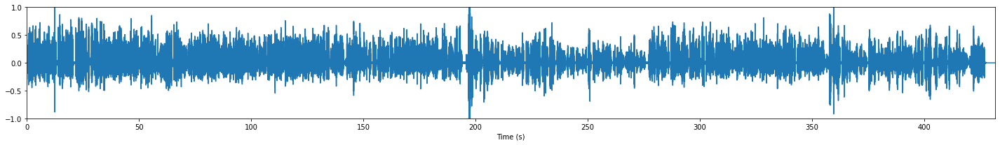

In [ ]:
waveplot(signal, fs, figsize=(20,3))
plt.show()

## Visualising Outputs

### Colour-coded waveplot

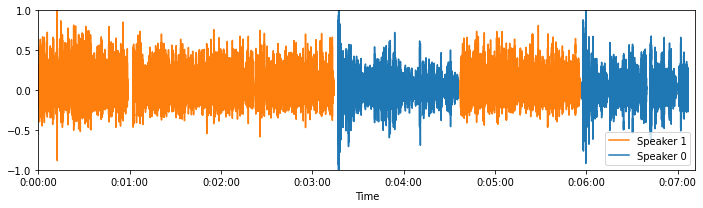

In [ ]:
combined_waveplot(signal, fs, segments, figsize=(10,3), tick_interval=60)
plt.show()

### Playing individual per-speaker snippets

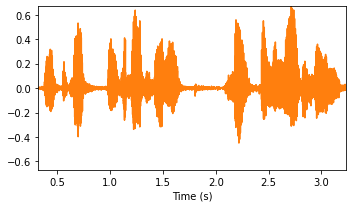

Speaker 1 (0.322s - 3.2299375s)


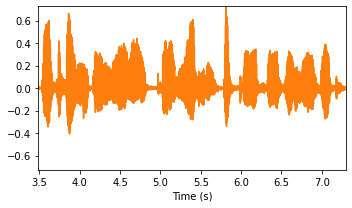

Speaker 1 (3.49s - 7.2939375s)


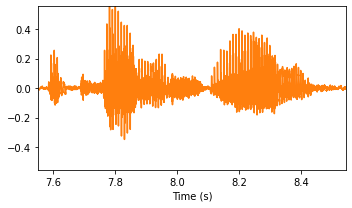

Speaker 1 (7.554s - 8.5419375s)


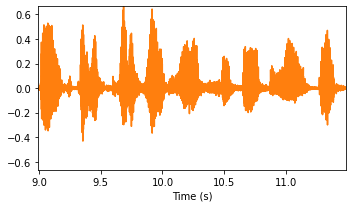

Speaker 1 (8.994s - 11.4859375s)


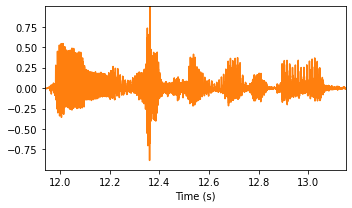

Speaker 1 (11.938s - 13.1499375s)


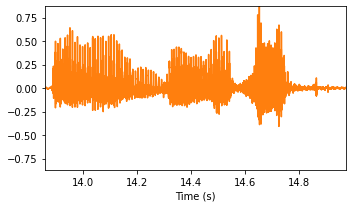

Speaker 1 (13.858s - 14.9739375s)


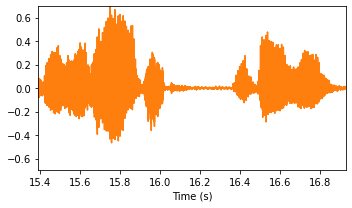

Speaker 1 (15.394s - 16.9259375s)


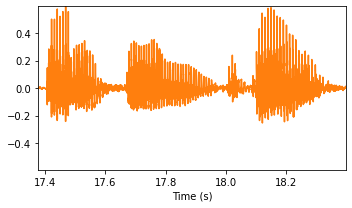

Speaker 1 (17.378s - 18.3979375s)


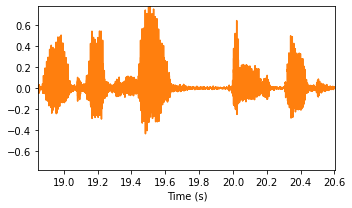

Speaker 1 (18.85s - 20.6059375s)


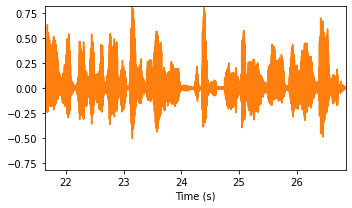

Speaker 1 (21.634s - 26.8459375s)


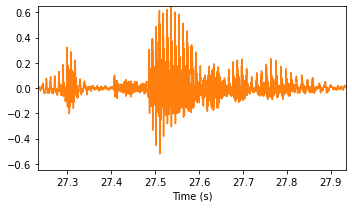

Speaker 1 (27.234s - 27.9339375s)


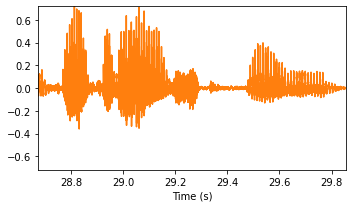

Speaker 1 (28.674s - 29.8539375s)


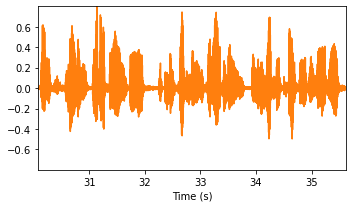

Speaker 1 (30.082s - 35.6139375s)


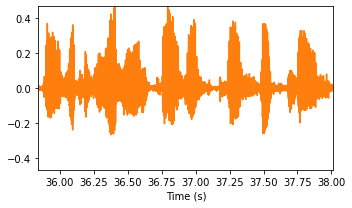

Speaker 1 (35.842s - 38.0139375s)


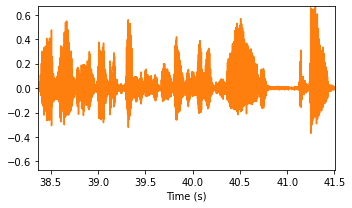

Speaker 1 (38.37s - 41.5019375s)


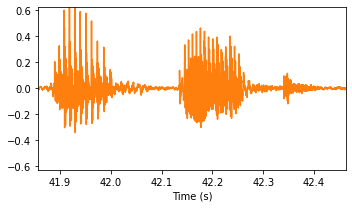

Speaker 1 (41.858s - 42.4619375s)


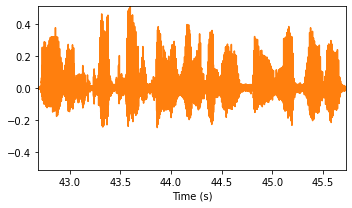

Speaker 1 (42.69s - 45.7259375s)


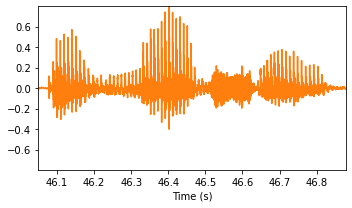

Speaker 1 (46.05s - 46.8779375s)


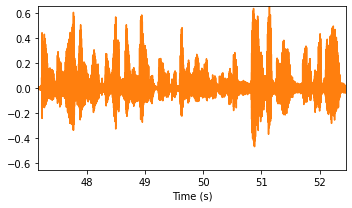

Speaker 1 (47.17s - 52.4459375s)


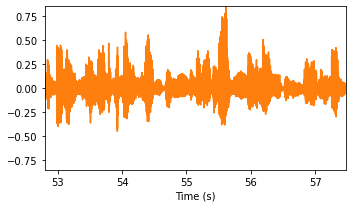

Speaker 1 (52.802s - 57.4699375s)


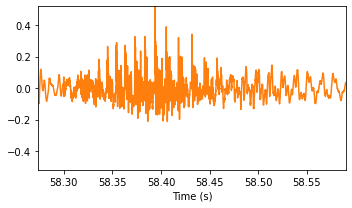

Speaker 1 (58.274s - 58.5899375s)


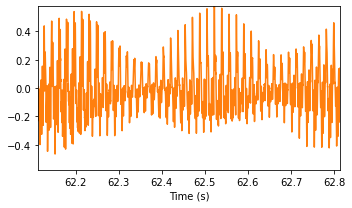

Speaker 1 (62.114s - 62.8139375s)


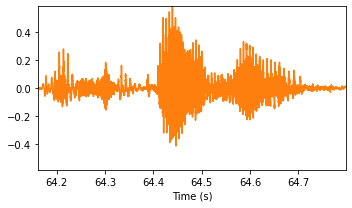

Speaker 1 (64.162s - 64.7979375s)


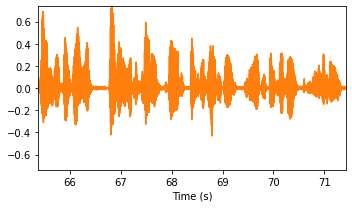

Speaker 1 (65.378s - 71.4219375s)


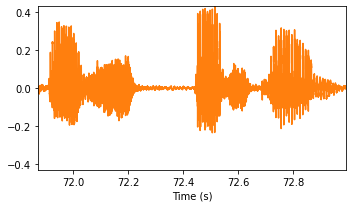

Speaker 1 (71.874s - 72.9899375s)


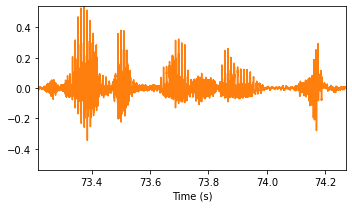

Speaker 1 (73.218s - 74.2699375s)


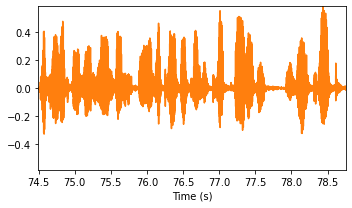

Speaker 1 (74.498s - 78.7499375s)


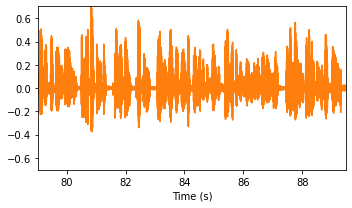

Speaker 1 (79.042s - 89.4699375s)


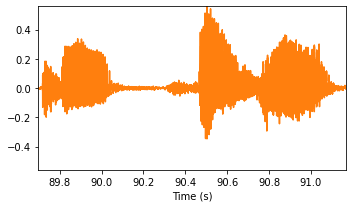

Speaker 1 (89.698s - 91.1659375s)


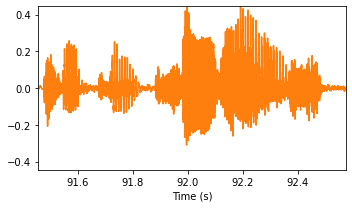

Speaker 1 (91.458s - 92.5739375s)


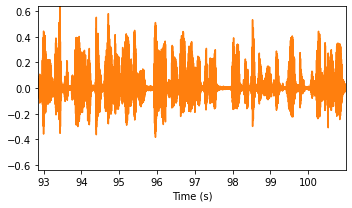

Speaker 1 (92.866s - 100.9899375s)


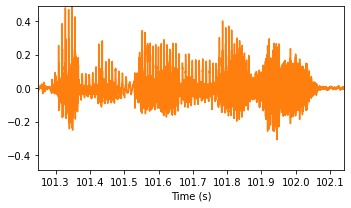

Speaker 1 (101.25s - 102.1419375s)


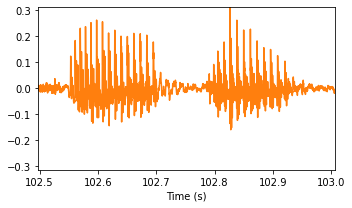

Speaker 1 (102.498s - 103.0059375s)


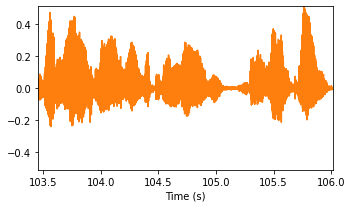

Speaker 1 (103.458s - 106.0139375s)


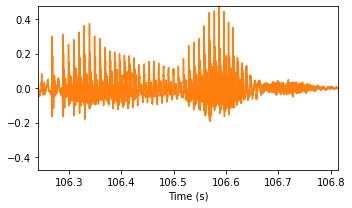

Speaker 1 (106.242s - 106.8139375s)


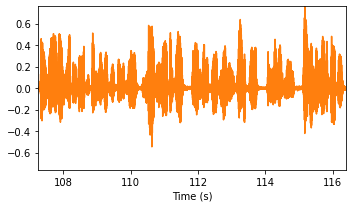

Speaker 1 (107.266s - 116.3819375s)


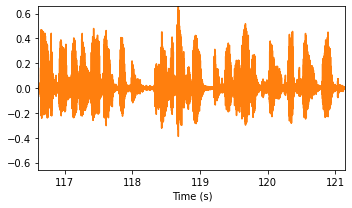

Speaker 1 (116.61s - 121.1499375s)


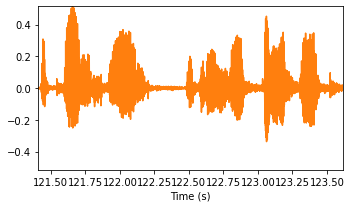

Speaker 1 (121.41s - 123.6139375s)


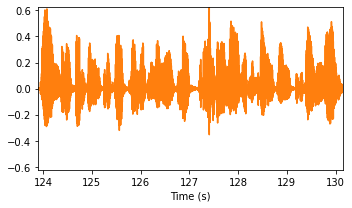

Speaker 1 (123.906s - 130.1419375s)


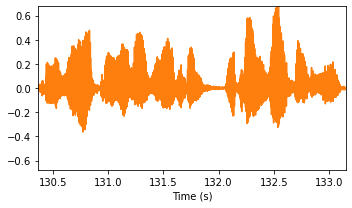

Speaker 1 (130.37s - 133.1499375s)


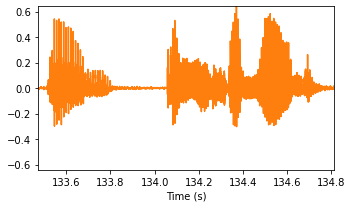

Speaker 1 (133.474s - 134.8139375s)


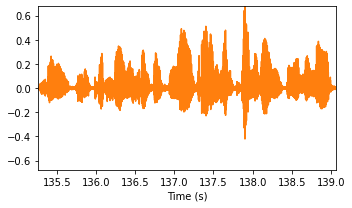

Speaker 1 (135.266s - 139.0699375s)


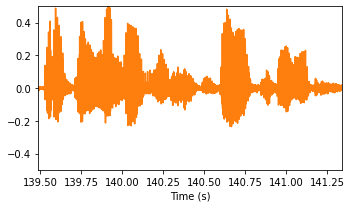

Speaker 1 (139.49s - 141.3419375s)


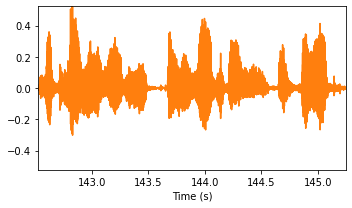

Speaker 1 (142.53s - 145.2459375s)


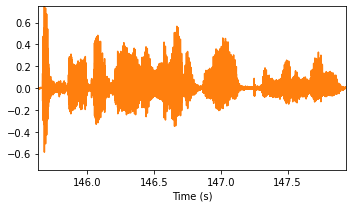

Speaker 1 (145.634s - 147.9339375s)


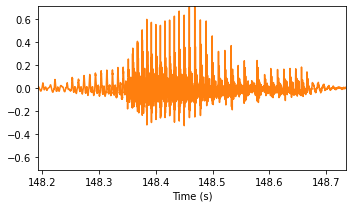

Speaker 1 (148.194s - 148.7339375s)


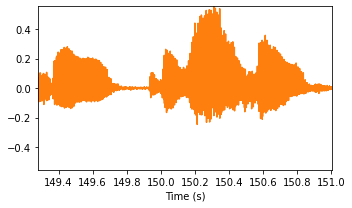

Speaker 1 (149.282s - 151.0059375s)


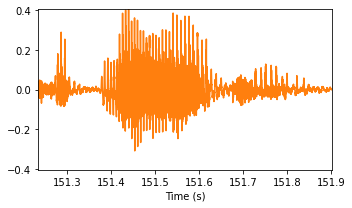

Speaker 1 (151.234s - 151.9019375s)


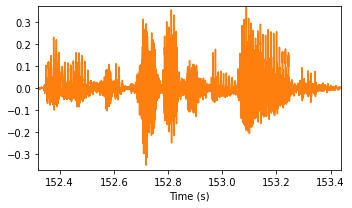

Speaker 1 (152.322s - 153.4379375s)


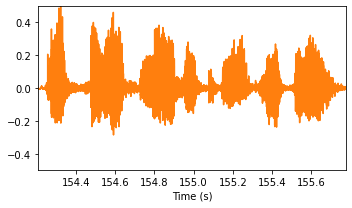

Speaker 1 (154.21s - 155.7739375s)


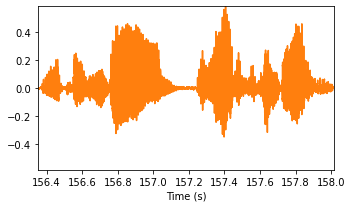

Speaker 1 (156.354s - 158.0139375s)


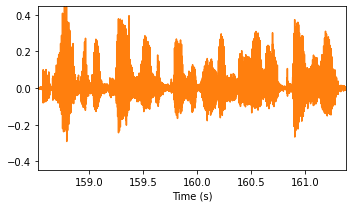

Speaker 1 (158.53s - 161.3739375s)


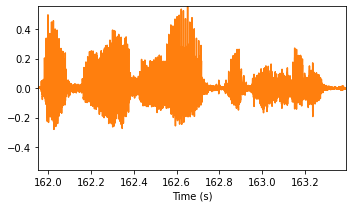

Speaker 1 (161.954s - 163.3899375s)


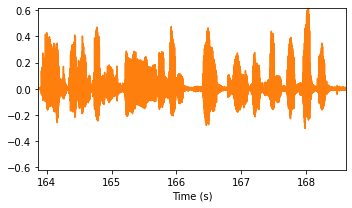

Speaker 1 (163.874s - 168.6059375s)


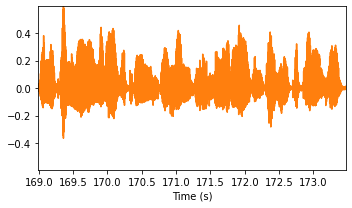

Speaker 1 (168.994s - 173.4699375s)


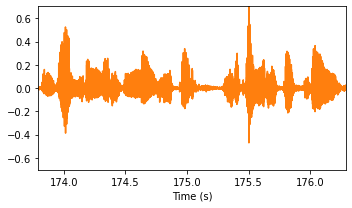

Speaker 1 (173.794s - 176.2859375s)


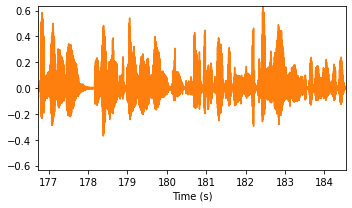

Speaker 1 (176.738s - 184.5419375s)


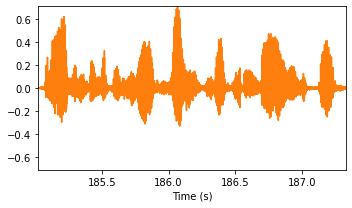

Speaker 1 (185.026s - 187.3259375s)


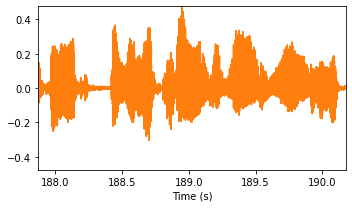

Speaker 1 (187.874s - 190.1739375s)


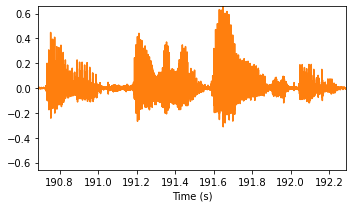

Speaker 1 (190.69s - 192.2859375s)


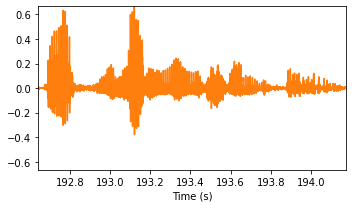

Speaker 1 (192.642s - 194.1739375s)


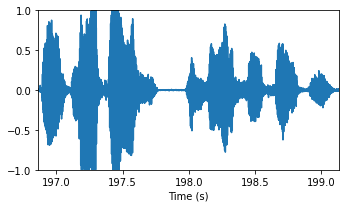

Speaker 0 (196.866s - 199.1339375s)


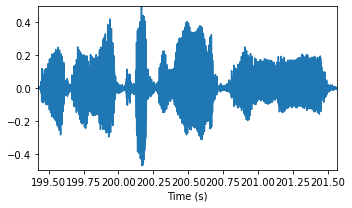

Speaker 0 (199.426s - 201.5659375s)


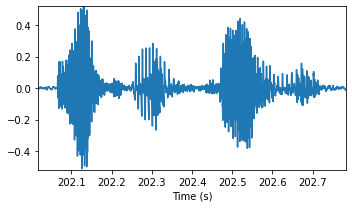

Speaker 0 (202.018s - 202.7819375s)


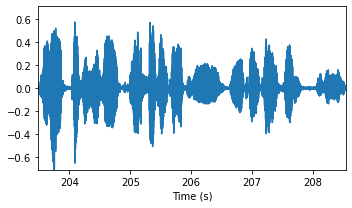

Speaker 0 (203.49s - 208.5419375s)


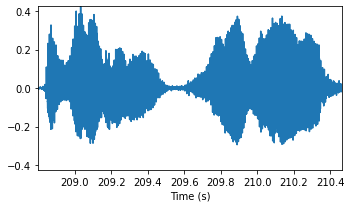

Speaker 0 (208.802s - 210.4619375s)


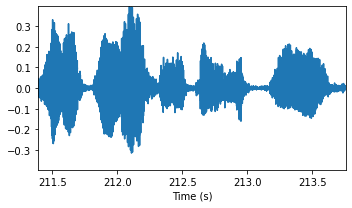

Speaker 0 (211.394s - 213.7579375s)


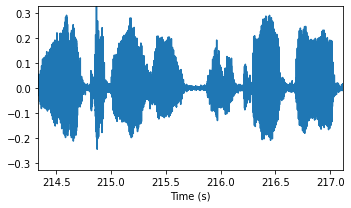

Speaker 0 (214.338s - 217.1179375s)


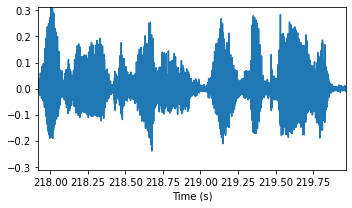

Speaker 0 (217.922s - 219.9659375s)


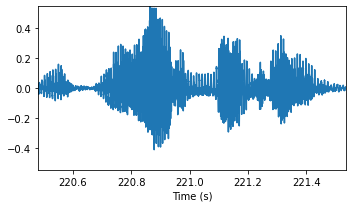

Speaker 0 (220.482s - 221.5339375s)


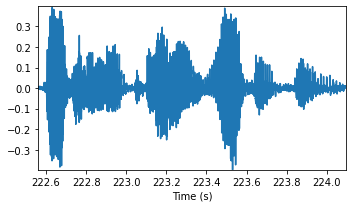

Speaker 0 (222.562s - 224.0939375s)


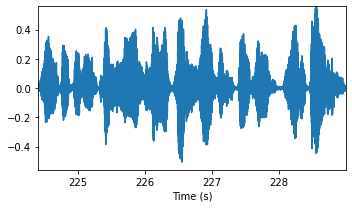

Speaker 0 (224.418s - 228.9899375s)


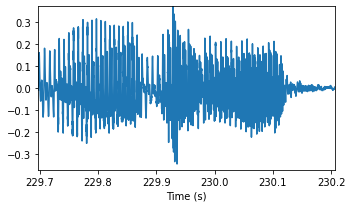

Speaker 0 (229.698s - 230.2059375s)


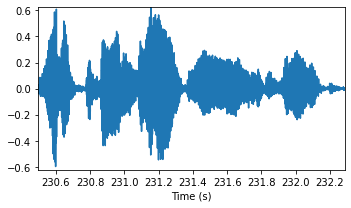

Speaker 0 (230.498s - 232.2859375s)


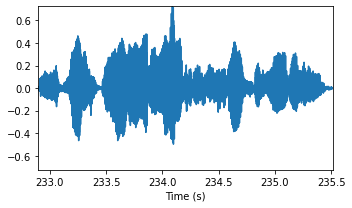

Speaker 0 (232.898s - 235.5179375s)


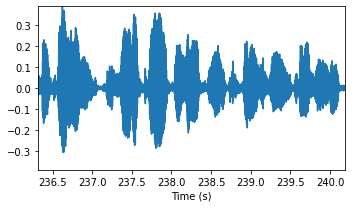

Speaker 0 (236.322s - 240.1899375s)


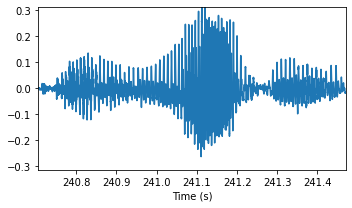

Speaker 0 (240.706s - 241.4699375s)


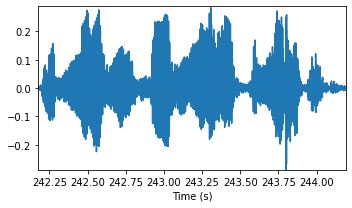

Speaker 0 (242.178s - 244.1899375s)


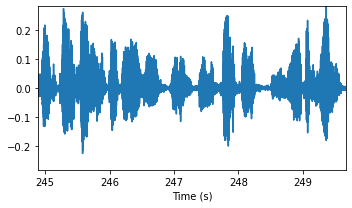

Speaker 0 (244.898s - 249.6619375s)


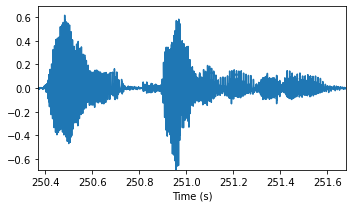

Speaker 0 (250.37s - 251.6779375s)


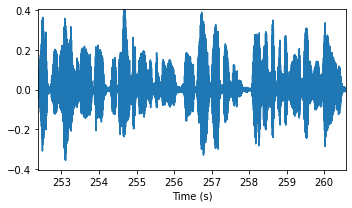

Speaker 0 (252.386s - 260.5739375s)


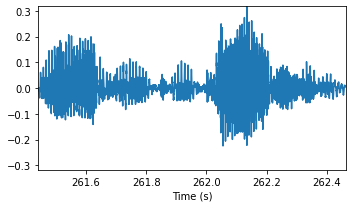

Speaker 0 (261.442s - 262.4619375s)


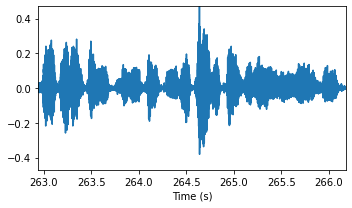

Speaker 0 (262.946s - 266.1739375s)


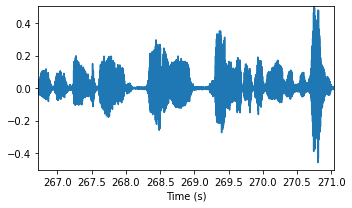

Speaker 0 (266.722s - 271.0379375s)


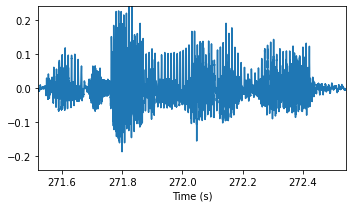

Speaker 0 (271.522s - 272.5419375s)


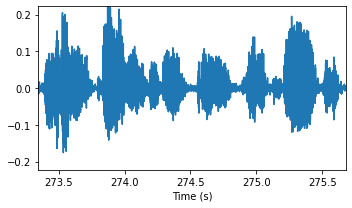

Speaker 0 (273.346s - 275.6779375s)


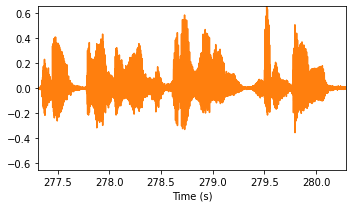

Speaker 1 (277.314s - 280.2859375s)


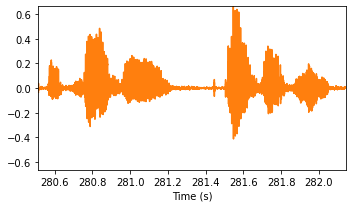

Speaker 1 (280.514s - 282.1419375s)


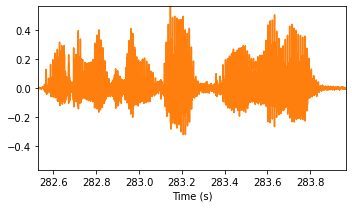

Speaker 1 (282.53s - 283.9659375s)


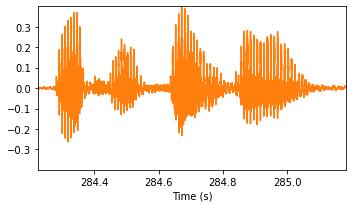

Speaker 1 (284.226s - 285.1819375s)


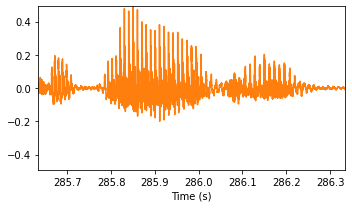

Speaker 1 (285.634s - 286.3339375s)


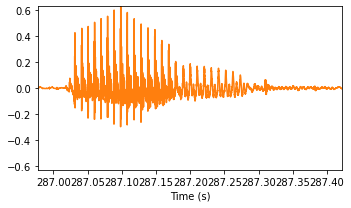

Speaker 1 (286.978s - 287.4219375s)


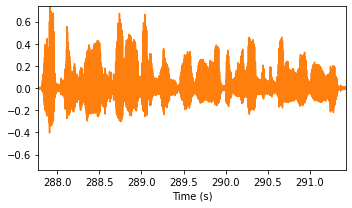

Speaker 1 (287.778s - 291.4219375s)


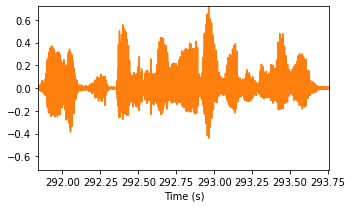

Speaker 1 (291.842s - 293.7579375s)


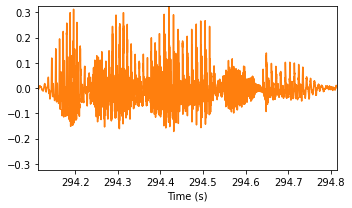

Speaker 1 (294.114s - 294.8139375s)


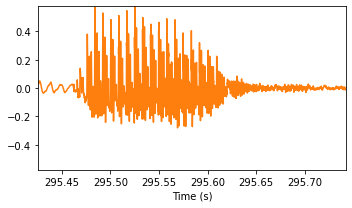

Speaker 1 (295.426s - 295.7419375s)


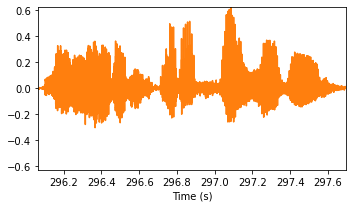

Speaker 1 (296.066s - 297.6939375s)


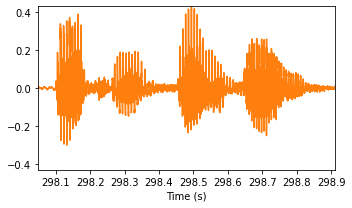

Speaker 1 (298.05s - 298.9099375s)


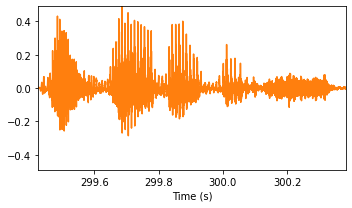

Speaker 1 (299.426s - 300.3819375s)


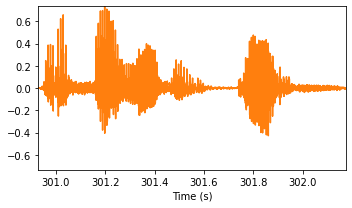

Speaker 1 (300.93s - 302.1739375s)


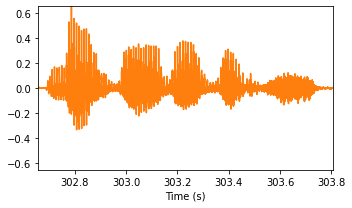

Speaker 1 (302.658s - 303.8059375s)


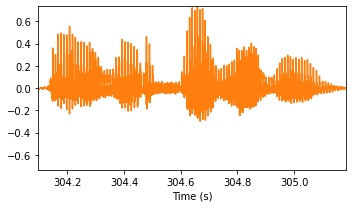

Speaker 1 (304.098s - 305.1819375s)


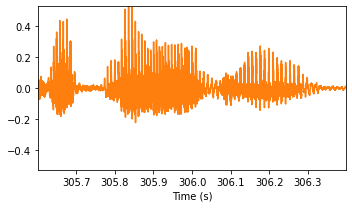

Speaker 1 (305.602s - 306.3979375s)


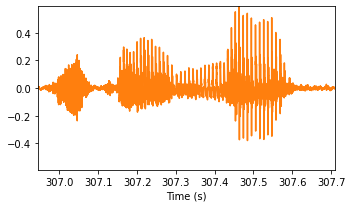

Speaker 1 (306.946s - 307.7099375s)


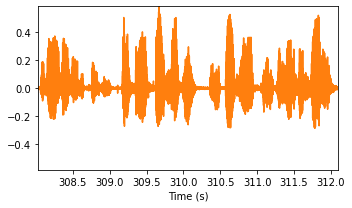

Speaker 1 (308.034s - 312.0939375s)


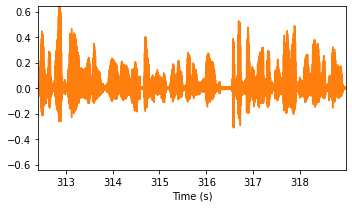

Speaker 1 (312.418s - 318.9739375s)


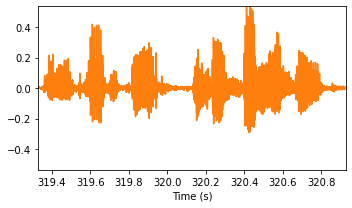

Speaker 1 (319.33s - 320.9259375s)


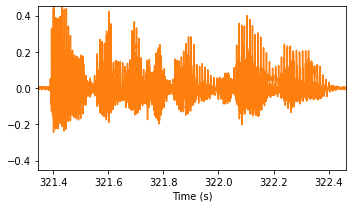

Speaker 1 (321.346s - 322.4619375s)


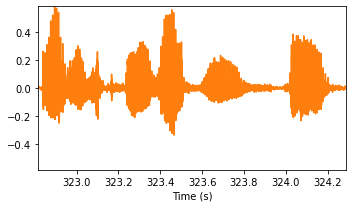

Speaker 1 (322.818s - 324.2859375s)


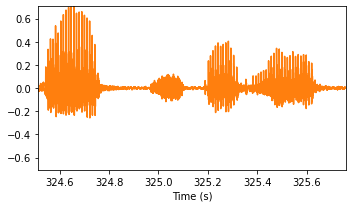

Speaker 1 (324.514s - 325.7579375s)


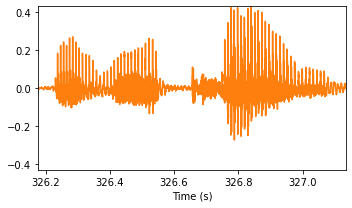

Speaker 1 (326.178s - 327.1339375s)


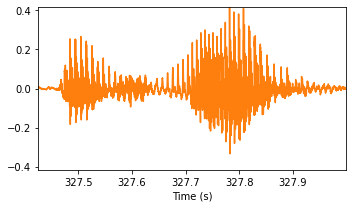

Speaker 1 (327.426s - 327.9979375s)


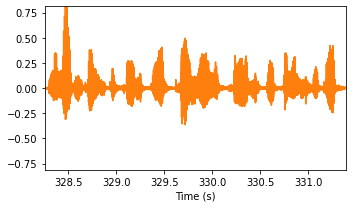

Speaker 1 (328.258s - 331.3899375s)


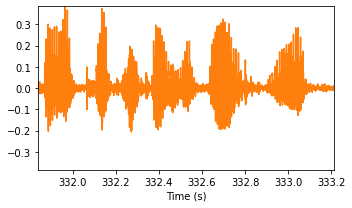

Speaker 1 (331.842s - 333.2139375s)


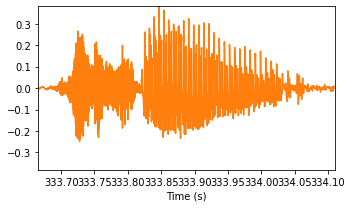

Speaker 1 (333.666s - 334.1099375s)


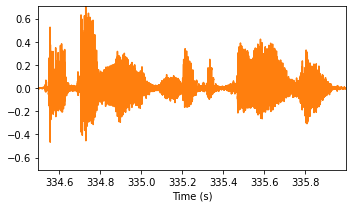

Speaker 1 (334.498s - 335.9979375s)


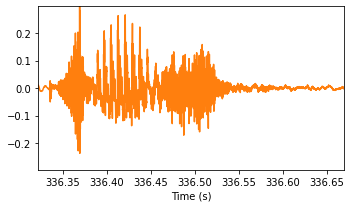

Speaker 1 (336.322s - 336.6699375s)


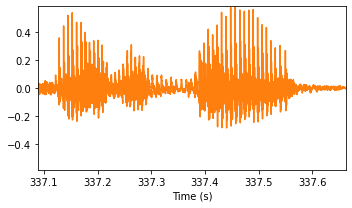

Speaker 1 (337.09s - 337.6619375s)


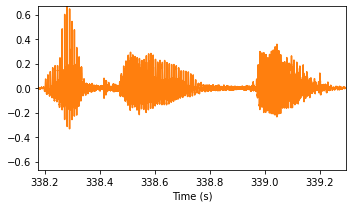

Speaker 1 (338.178s - 339.2939375s)


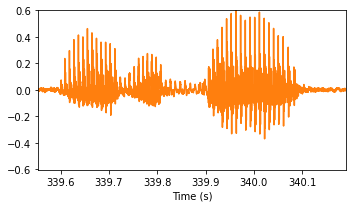

Speaker 1 (339.554s - 340.1899375s)


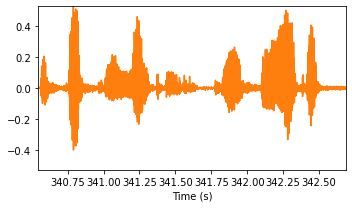

Speaker 1 (340.546s - 342.6859375s)


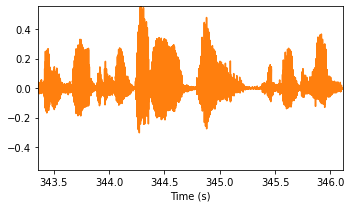

Speaker 1 (343.362s - 346.1099375s)


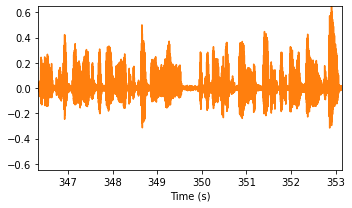

Speaker 1 (346.338s - 353.1499375s)


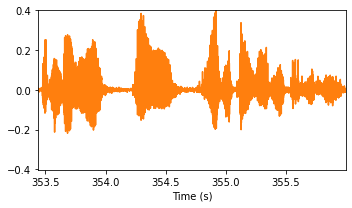

Speaker 1 (353.442s - 355.9979375s)


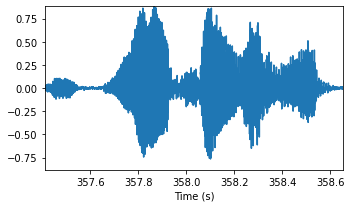

Speaker 0 (357.41s - 358.6539375s)


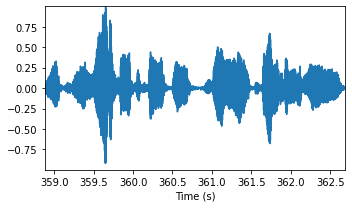

Speaker 0 (358.882s - 362.6859375s)


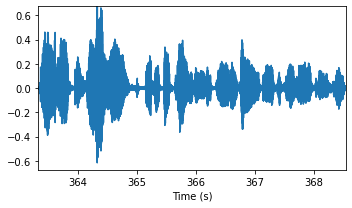

Speaker 0 (363.33s - 368.5419375s)


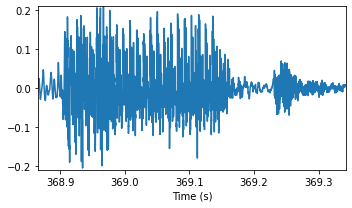

Speaker 0 (368.866s - 369.3419375s)


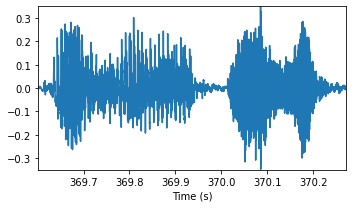

Speaker 0 (369.602s - 370.2699375s)


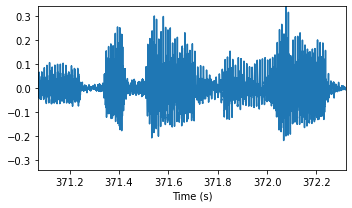

Speaker 0 (371.074s - 372.3179375s)


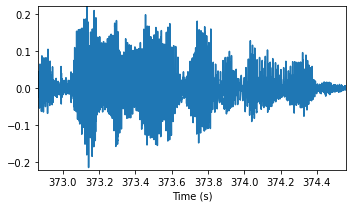

Speaker 0 (372.866s - 374.5579375s)


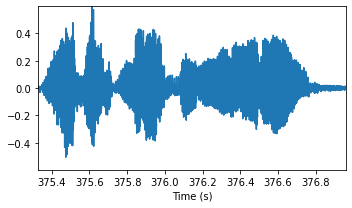

Speaker 0 (375.33s - 376.9579375s)


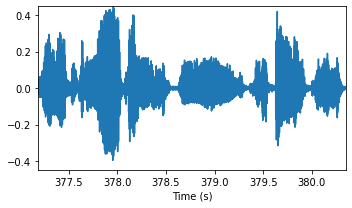

Speaker 0 (377.186s - 380.3499375s)


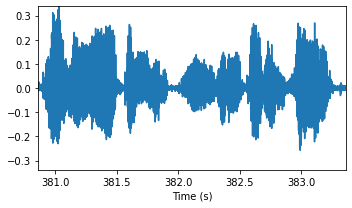

Speaker 0 (380.866s - 383.3579375s)


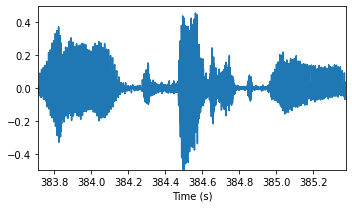

Speaker 0 (383.714s - 385.3739375s)


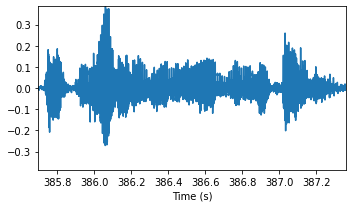

Speaker 0 (385.698s - 387.3579375s)


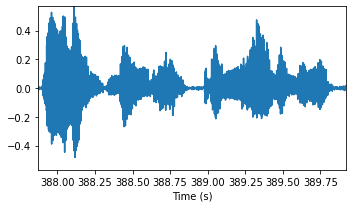

Speaker 0 (387.874s - 389.9179375s)


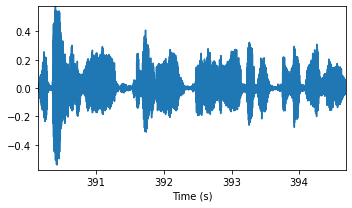

Speaker 0 (390.146s - 394.6859375s)


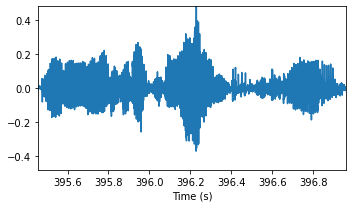

Speaker 0 (395.458s - 396.9579375s)


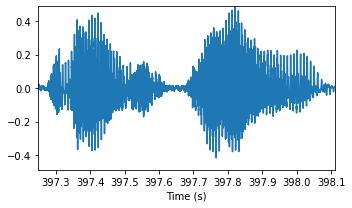

Speaker 0 (397.25s - 398.1099375s)


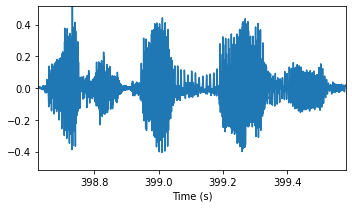

Speaker 0 (398.626s - 399.5819375s)


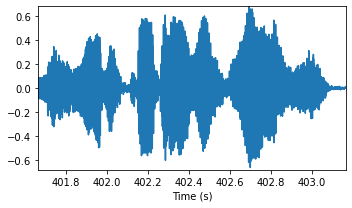

Speaker 0 (401.666s - 403.1659375s)


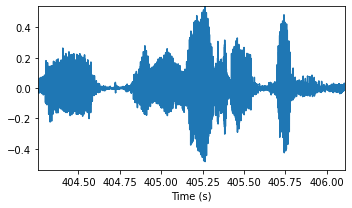

Speaker 0 (404.258s - 406.1099375s)


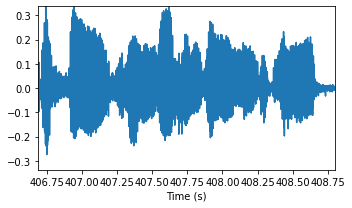

Speaker 0 (406.69s - 408.7979375s)


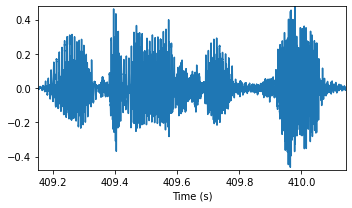

Speaker 0 (409.154s - 410.1419375s)


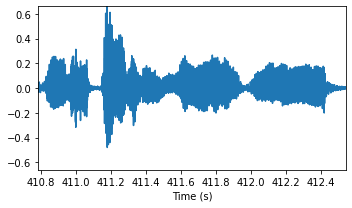

Speaker 0 (410.786s - 412.5419375s)


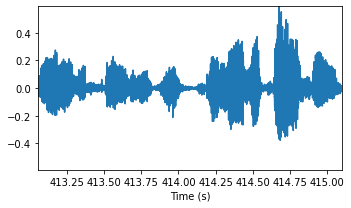

Speaker 0 (413.058s - 415.1019375s)


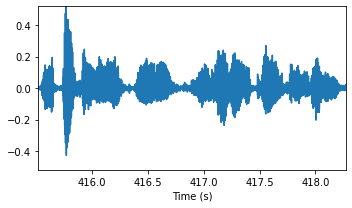

Speaker 0 (415.522s - 418.2699375s)


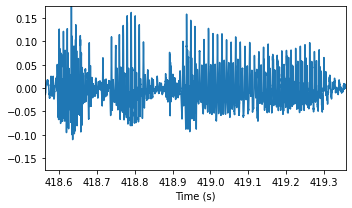

Speaker 0 (418.562s - 419.3579375s)


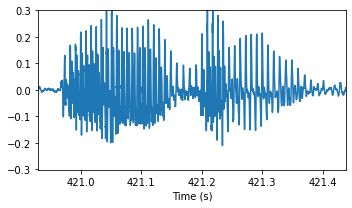

Speaker 0 (420.93s - 421.4379375s)


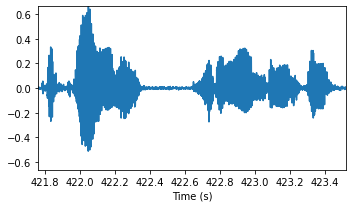

Speaker 0 (421.762s - 423.5179375s)


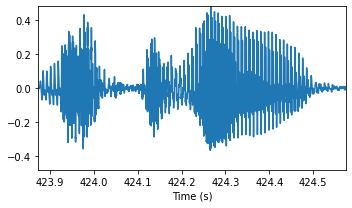

Speaker 0 (423.874s - 424.5739375s)


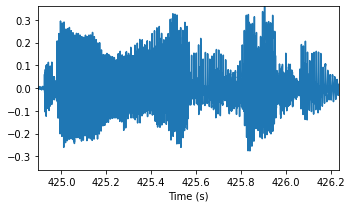

Speaker 0 (424.898s - 426.2379375s)


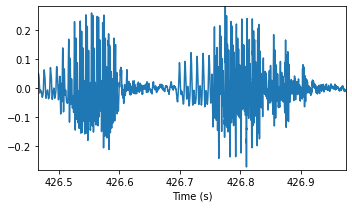

Speaker 0 (426.466s - 426.9739375s)


In [ ]:
waveplot_perspeaker(signal, fs, segments)

# Helper functions for diarizing YouTube

In [ ]:
!pip install pytube
from pytube.extract import video_id

def get_youtube_id(url):
    """
    Returns the youtube id for a youtube URL
    """
    return video_id(url)

def download_youtube_wav(youtube_id, outfolder='./', overwrite=True):
    """
    Download the audio for a YouTube id/URL
    """
    if validators.url(youtube_id):
        youtube_id = video_id(youtube_id)

    os.makedirs(outfolder, exist_ok=True)

    outfile = os.path.join(outfolder, '{}.wav'.format(youtube_id))
    if not overwrite:
        if os.path.isfile(outfile):
            return outfile

    cmd = "youtube-dl --no-continue --extract-audio --audio-format wav -o '{}' {}".format(
        outfile, youtube_id)
    subprocess.Popen(cmd, shell=True).wait()

    assert os.path.isfile(outfile), "Couldn't find expected outfile, something went wrong"
    return outfile


def diarize_yt(youtube_url, diar, ns=None):
    youtube_id = get_youtube_id(youtube_url)
    with tempfile.TemporaryDirectory() as outdir:
        print("Downloading wav file...")
        yt_file = download_youtube_wav(youtube_id, outdir)

        wav_file = convert_wavfile(yt_file, f"{outdir}/{youtube_id}_converted.wav")
        signal, fs = sf.read(wav_file)

        print(f"Diarizing {youtube_id}...")
        segments = diar.diarize(wav_file, 
                                num_speakers=ns,
                                outfile=f"{outdir}/{youtube_id}.rttm")
        return segments, (signal, fs)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.0/57.0 KB 8.1 MB/s eta 0:00:00


In [ ]:
diar = Diarizer(
                embed_model='ecapa', # supported types: ['xvec', 'ecapa']
                cluster_method='sc', # supported types: ['ahc', 'sc']
                window=1.5, # size of window to extract embeddings (in seconds)
                period=0.75 # hop of window (in seconds)
                )

Using cache found in /root/.cache/torch/hub/snakers4_silero-vad_master


## It's Always Sunny in Philadelphia (Pepe Silvia)


In [ ]:
iasip_video = "https://www.youtube.com/watch?v=ghrdSTC66MA"
HTML('<iframe width="560" height="315" src="https://www.youtube.com/embed/{}?rel=0&amp;controls=0&amp;showinfo=0" frameborder="0" allowfullscreen></iframe>'.format(get_youtube_id(iasip_video)))

/usr/local/lib/python3.8/dist-packages/IPython/core/display.py:701: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")


In [ ]:
iasip_segments, (iasip_signal, fs) = diarize_yt(iasip_video, diar, 2)

Diarizing ghrdSTC66MA...
Running VAD...
Splitting by silence found 13 utterances
Extracting embeddings...


Utterances:   0%|          | 0/13 [00:00<?, ?it/s]

Clustering to 2 speakers...
Cleaning up output...
Done!


/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_spectral_embedding.py:234: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


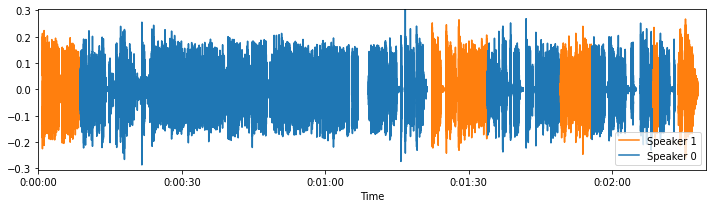

In [ ]:
combined_waveplot(iasip_signal, fs, iasip_segments, tick_interval=30)
plt.show()

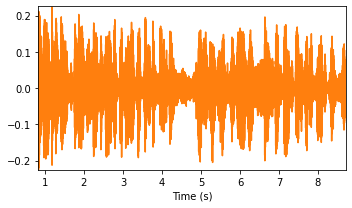

Speaker 1 (0.834s - 8.709s)


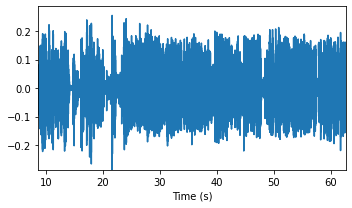

Speaker 0 (8.709s - 62.5899375s)


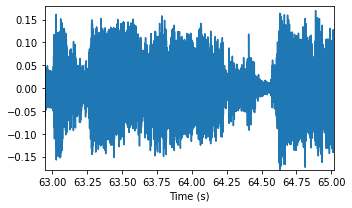

Speaker 0 (62.946s - 65.0219375s)


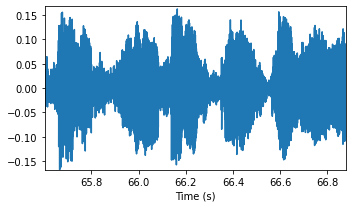

Speaker 0 (65.602s - 66.8779375s)


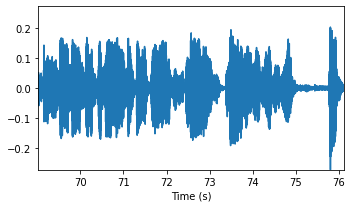

Speaker 0 (69.026s - 76.1259375s)


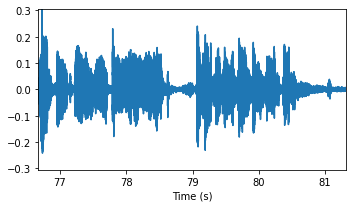

Speaker 0 (76.674s - 81.3099375s)


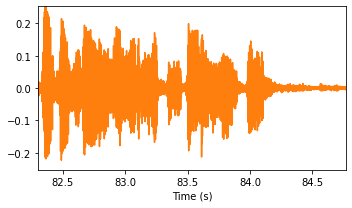

Speaker 1 (82.306s - 84.7659375s)


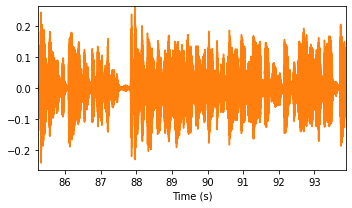

Speaker 1 (85.25s - 93.875s)


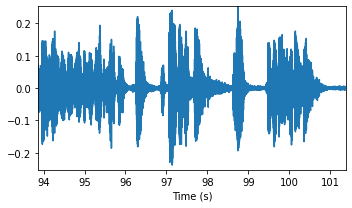

Speaker 0 (93.875s - 101.3739375s)


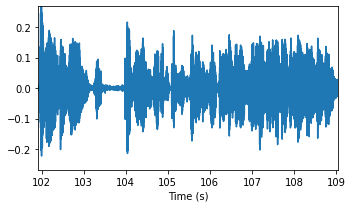

Speaker 0 (101.922s - 109.047s)


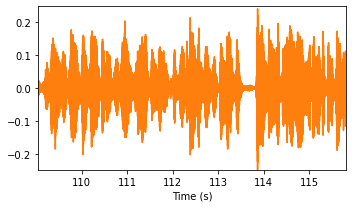

Speaker 1 (109.047s - 115.797s)


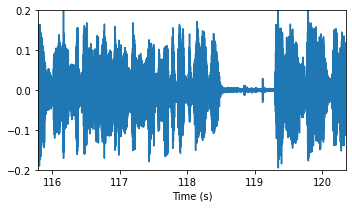

Speaker 0 (115.797s - 120.3499375s)


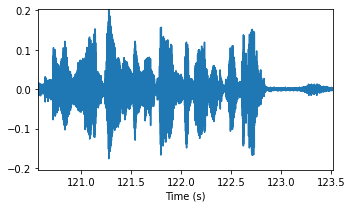

Speaker 0 (120.578s - 123.5179375s)


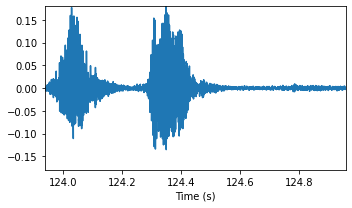

Speaker 0 (123.938s - 124.9579375s)


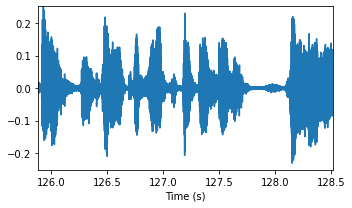

Speaker 0 (125.89s - 128.515s)


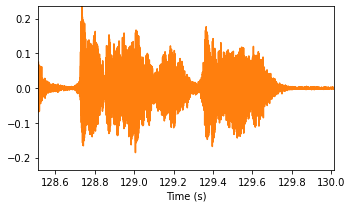

Speaker 1 (128.515s - 130.015s)


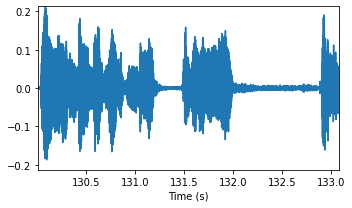

Speaker 0 (130.015s - 133.0859375s)


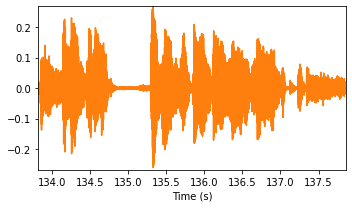

Speaker 1 (133.826s - 137.8539375s)


In [ ]:
waveplot_perspeaker(iasip_signal, fs, iasip_segments)

Scrolling through the snippets the speaker segments are isolated correctly but the transcripts are not aligned well

## 5 Person Interview

In [ ]:
outih_video = "https://youtu.be/h_W12HmsIMY"
HTML('<iframe width="560" height="315" src="https://www.youtube.com/embed/{}?rel=0&amp;controls=0&amp;showinfo=0" frameborder="0" allowfullscreen></iframe>'.format(get_youtube_id(outih_video)))

/usr/local/lib/python3.8/dist-packages/IPython/core/display.py:701: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")


In [ ]:
outih_segments, (outih_signal, fs) = diarize_yt(outih_video, diar, 5)

Diarizing h_W12HmsIMY...
Running VAD...
Splitting by silence found 217 utterances
Extracting embeddings...


Utterances:   0%|          | 0/217 [00:00<?, ?it/s]

Clustering to 5 speakers...


/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_spectral_embedding.py:234: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


Cleaning up output...
Done!


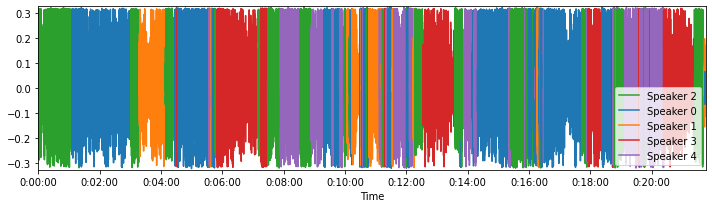

In [ ]:
combined_waveplot(outih_signal, fs, outih_segments, tick_interval=120)
plt.show()

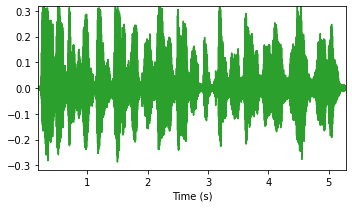

Speaker 2 (0.194s - 5.2779375s)


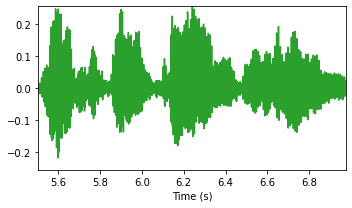

Speaker 2 (5.506s - 6.9739375s)


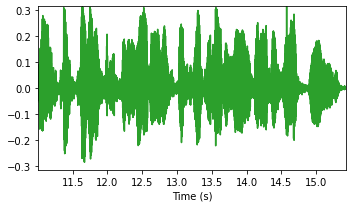

Speaker 2 (11.01s - 15.4219375s)


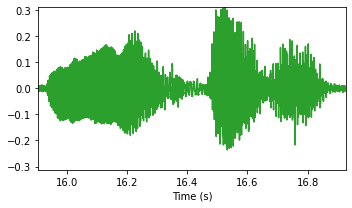

Speaker 2 (15.906s - 16.9259375s)


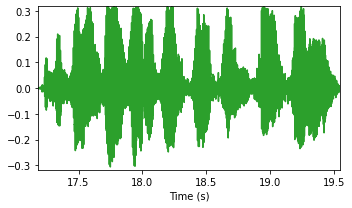

Speaker 2 (17.186s - 19.5499375s)


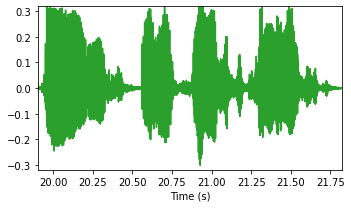

Speaker 2 (19.906s - 21.8219375s)


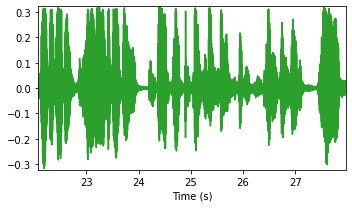

Speaker 2 (22.082s - 27.9659375s)


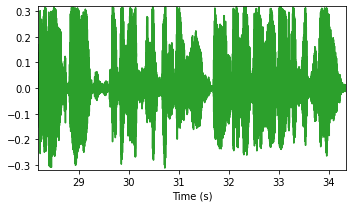

Speaker 2 (28.194s - 34.3339375s)


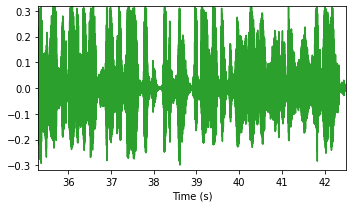

Speaker 2 (35.298s - 42.4939375s)


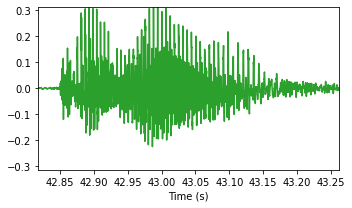

Speaker 2 (42.818s - 43.2619375s)


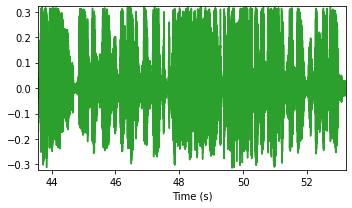

Speaker 2 (43.586s - 53.2139375s)


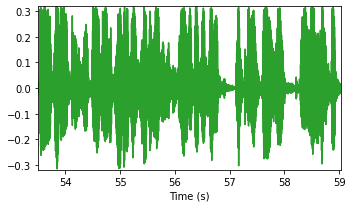

Speaker 2 (53.506s - 59.0379375s)


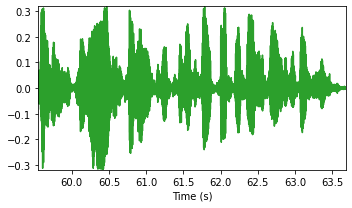

Speaker 2 (59.554s - 63.6779375s)


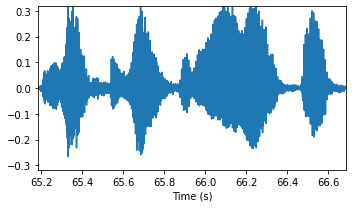

Speaker 0 (65.186s - 66.6859375s)


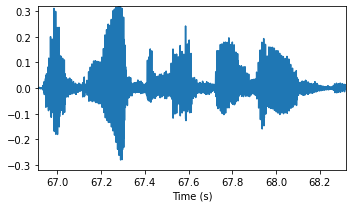

Speaker 0 (66.914s - 68.3179375s)


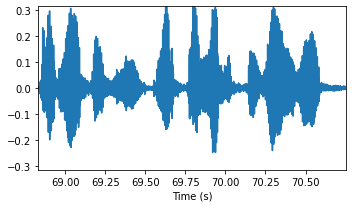

Speaker 0 (68.834s - 70.7499375s)


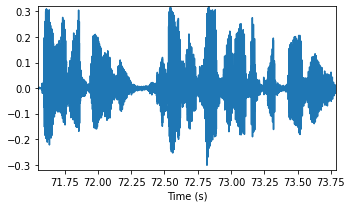

Speaker 0 (71.554s - 73.7899375s)


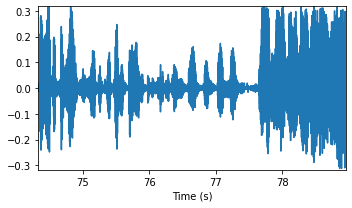

Speaker 0 (74.338s - 78.947s)


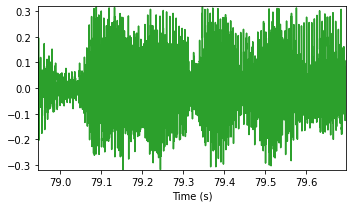

Speaker 2 (78.947s - 79.697s)


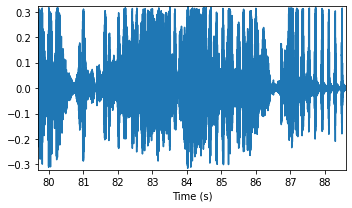

Speaker 0 (79.697s - 88.6059375s)


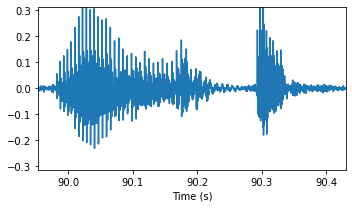

Speaker 0 (89.954s - 90.4299375s)


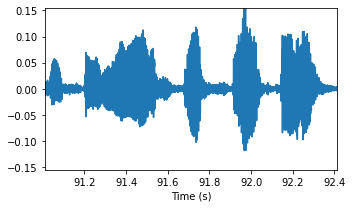

Speaker 0 (91.01s - 92.4139375s)


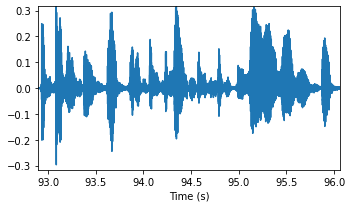

Speaker 0 (92.898s - 96.0619375s)


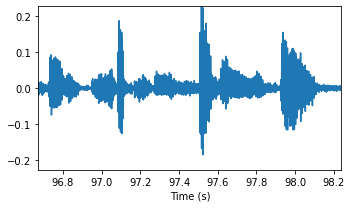

Speaker 0 (96.674s - 98.2379375s)


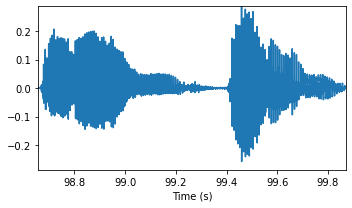

Speaker 0 (98.658s - 99.8699375s)


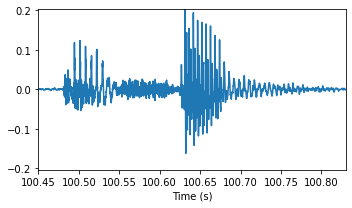

Speaker 0 (100.45s - 100.8299375s)


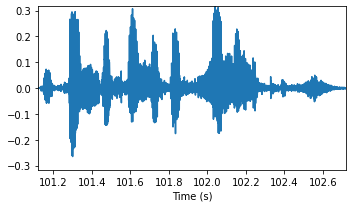

Speaker 0 (101.122s - 102.7179375s)


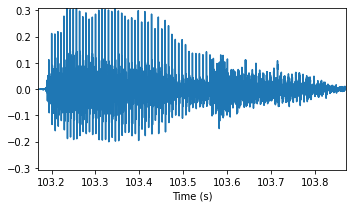

Speaker 0 (103.17s - 103.8699375s)


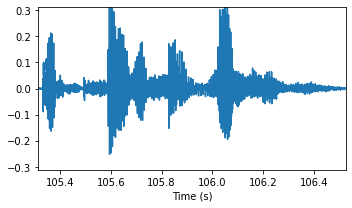

Speaker 0 (105.314s - 106.5259375s)


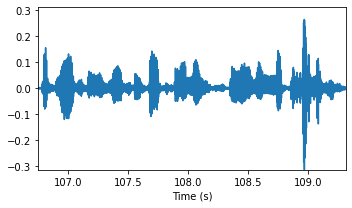

Speaker 0 (106.754s - 109.3099375s)


In [ ]:
waveplot_perspeaker(outih_signal, fs, outih_segments[:30])